In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt    # Loading necessary libraries 
import seaborn as sns
import folium
from scipy import stats

# Set display options for pandas
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

# Set the style for our visualizations
plt.style.use('seaborn-v0_8')  
sns.set_palette("husl")

%matplotlib inline

In [5]:
# Load the dataset
license = pd.read_excel('Atlanta_Business_License_Records_2025.xlsx')

# Display the first few rows
print("First 5 rows of the dataset:")
print(license.head())

# Display basic information about the dataset
print("\nDataset Info:")
license.info()

# Display basic statistical summary
print("\nBasic Statistical Summary:")
print(license.describe())

# Display number of missing values in each column
print("\nMissing Values Count:")
print(license.isnull().sum())

First 5 rows of the dataset:
   license_number                  company_name company_dba  \
0  GBL-0121-00257           H & H Interiors LLC         NaN   
1  GBL-0121-00258          One Lion Studios LLC         NaN   
2  GBL-0121-00272         Destingkt Designs LLC         NaN   
3  GBL-0121-00274                Mac Cigars LLC  J's Cigars   
4  GBL-0121-00283  Essence of She Day Spa Salon         NaN   

                        license_classification             issued_date  \
0  Other Services except Public Administration 2025-01-07 13:21:16.143   
1  Other Services except Public Administration 2025-02-16 18:39:21.153   
2  Other Services except Public Administration 2025-03-04 23:04:53.980   
3                                 Retail Trade 2025-02-25 23:09:11.497   
4  Other Services except Public Administration 2025-01-09 19:04:30.857   

   naics_code                naics_name predirection          address_line1  \
0    541410.0  Interior Design Services           NE          2652 F

### Missing Values Analysis

The code output shows the number of missing values in each column of the dataset using `license.isnull().sum()`. Based on the first few rows displayed, several columns contain missing data.

- **company_dba** has many missing entries because most businesses operate under their official registered name rather than a “Doing Business As” alias.  
- **predirection**, **address_line2**, **street_type**, and **unit_suite** also show missing values, which is expected since not every business address includes a street direction, secondary address, or suite number.  
- Columns such as **address_concat**, **address_api**, and other derived address fields may also contain missing values if geocoding or data standardization was incomplete.  
- Core identifying and business-related variables like **license_number**, **company_name**, **license_classification**, **issued_date**, and **naics_code** appear complete, indicating the dataset’s primary structure is intact.  

Overall, the missing values are concentrated in optional or location-specific fields rather than critical identifiers. This pattern suggests that the dataset is relatively suitable for analysis, though address-based mapping or spatial analysis may require additional data cleaning and imputation.

In [6]:
# Display all column names
print("All columns in the dataset:")
print("\n".join(license.columns.tolist()))

All columns in the dataset:
license_number
company_name
company_dba
license_classification
issued_date
naics_code
naics_name
predirection
address_line1
address_line2
street_type
postdirection
unit_suite
city
state
postal_code
address_concat
address_api
longitude
latitude
disinvested_neighborhood
council_district
npu


### Section 1: Variable Analysis

#### 1. Identifiers
**license_number** – Unique identifier for each business license issued by the City of Atlanta.  
**company_name** – Registered name of the business entity holding the license.  
**company_dba** – "Doing Business As" name, used when the business operates under a trade or brand name different from the registered one.  
These columns uniquely identify each licensed business.  

#### 2. Business Information
**license_classification** – Categorizes the type of business activity, such as Retail Trade, Accommodation and Food Services, or Other Services except Public Administration.  
**issued_date** – Date and time when the license was officially issued in 2025.  
**naics_code** – Numeric code representing the business industry according to the North American Industry Classification System (NAICS).  
**naics_name** – Full description of the NAICS code, detailing the type of business activity (e.g., Interior Design Services, Health Care & Social Assistance).  
These variables capture what kind of business activity is licensed and when it became active.  

#### 3. Address Components
**predirection**, **street_type**, **postdirection** – Standardized address components used for mapping and consistency in street naming (e.g., NE, AVE, ST).  
**address_line1**, **address_line2**, **unit_suite** – Main street address, secondary address information (such as building or floor), and unit or suite identifiers for the business location.  
**city**, **state**, **postal_code** – Geographic location information identifying where the business operates. All entries are based in Atlanta, GA, with various postal codes.  
**address_concat**, **address_api** – Concatenated or API-verified address fields used for mapping or geocoding.  
These variables allow for accurate spatial analysis and mapping of business locations across the city.  

#### 4. Geospatial Variables
**longitude**, **latitude** – Geographic coordinates of the business location, used for geospatial visualization and analysis.  
These enable visualization of business distributions and proximity to different neighborhoods or infrastructure.  

#### 5. Administrative and Neighborhood Indicators
**disinvested_neighborhood** – Boolean indicator (TRUE/FALSE) denoting whether the business is located in a historically disinvested or economically disadvantaged neighborhood.  
**council_district** – Numeric and letter-coded variable showing the City Council district where the business operates (e.g., 7 B, 4 M).  
**npu** – Neighborhood Planning Unit (NPU) designation, representing local community zones used for planning and public engagement (e.g., E, B, M, L).  
These features support equity-focused or policy analyses by connecting businesses to governance and socioeconomic geography.  


### Section 2: Business Distribution and Counts Visualizations
- **Bar chart of license_classification**  
  Show how many businesses fall under each classification (e.g., Retail Trade, Food Services, Other Services).  
  *Purpose:* Identify dominant sectors among newly licensed small businesses in Atlanta.  

- **Bar chart of naics_name**  
  Display the top 10 most common business types using NAICS names.  
  *Purpose:* Highlight the most frequent business activities (e.g., beauty salons, restaurants, design services).  

- **Histogram of issued_date**  
  Plot licenses by issuance month or week.  
  *Purpose:* Examine temporal trends in new business formation throughout 2025.

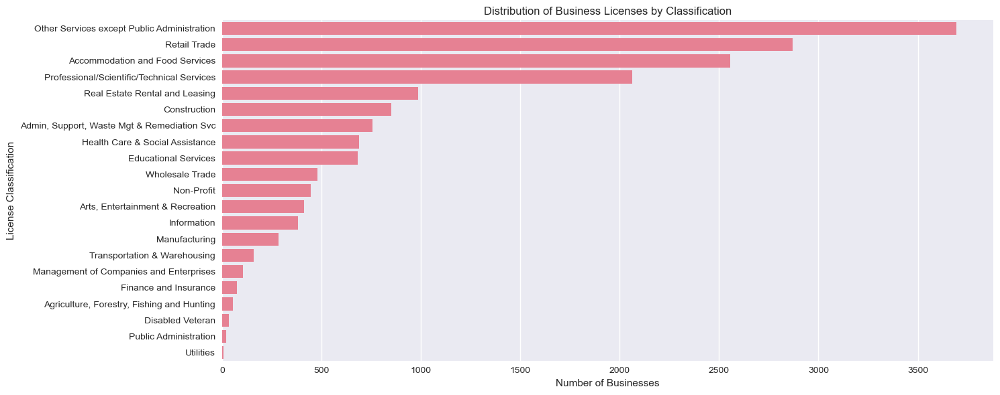

In [7]:
# Set figure size for better visualization
plt.figure(figsize=(15, 6))

# Create bar chart of license classifications
sns.countplot(data=license, y='license_classification', order=license['license_classification'].value_counts().index)
plt.title('Distribution of Business Licenses by Classification')
plt.xlabel('Number of Businesses')
plt.ylabel('License Classification')

# Adjust layout
plt.tight_layout()
plt.show()

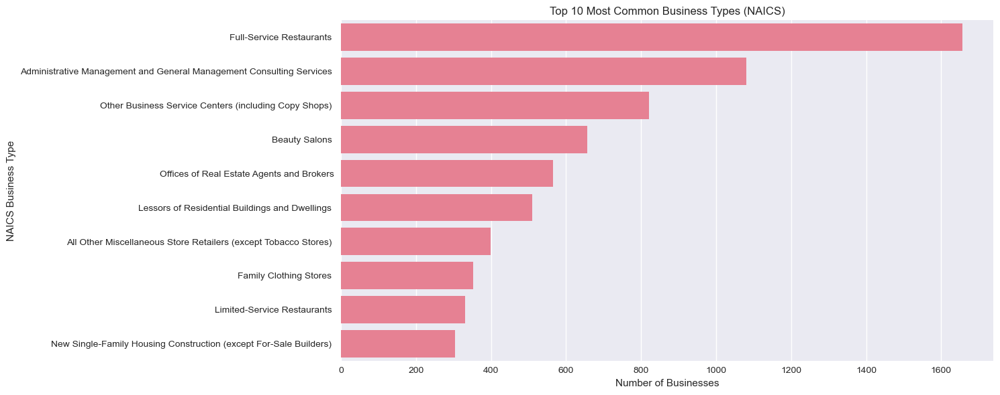

In [8]:
# Set figure size for better visualization
plt.figure(figsize=(15, 6))

# Create bar chart of top 10 NAICS names
top_10_naics = license['naics_name'].value_counts().head(10)
sns.barplot(x=top_10_naics.values, y=top_10_naics.index)
plt.title('Top 10 Most Common Business Types (NAICS)')
plt.xlabel('Number of Businesses')
plt.ylabel('NAICS Business Type')

# Adjust layout
plt.tight_layout()
plt.show()

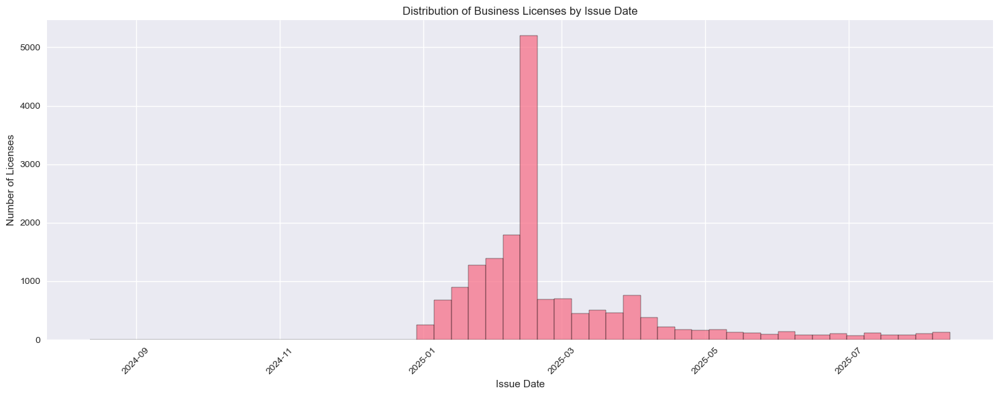

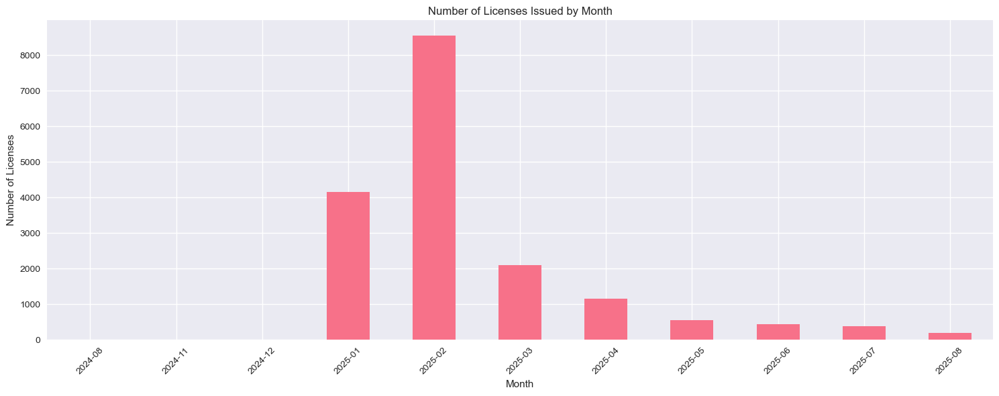

In [9]:
# Convert issued_date to datetime 
license['issued_date'] = pd.to_datetime(license['issued_date'])

# Set figure size
plt.figure(figsize=(15, 6))

# Create histogram of issued dates by month
sns.histplot(data=license, x='issued_date', bins=50)
plt.title('Distribution of Business Licenses by Issue Date')
plt.xlabel('Issue Date')
plt.ylabel('Number of Licenses')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

# Additional monthly trend analysis
monthly_counts = license['issued_date'].dt.to_period('M').value_counts().sort_index()
plt.figure(figsize=(15, 6))
monthly_counts.plot(kind='bar')
plt.title('Number of Licenses Issued by Month')
plt.xlabel('Month')
plt.ylabel('Number of Licenses')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Section 3: Geographic and Spatial Analysis Visualizations
- **Scatter map (longitude vs. latitude)**  
  Plot all business locations on a city map of Atlanta using longitude and latitude coordinates.  
  *Purpose:* Visualize spatial distribution and clustering of businesses.  

- **Choropleth map by council_district or NPU**  
  Aggregate the number of businesses per district or neighborhood planning unit (NPU).  
  *Purpose:* Identify areas with high or low small-business density.  

- **Highlight disinvested_neighborhood**  
  Use color to differentiate businesses located in disinvested neighborhoods (TRUE/FALSE).  
  *Purpose:* Compare economic activity between historically underinvested areas and others.  

In [12]:
# Create a base map centered on Atlanta
atlanta_center = [33.7490, -84.3880]
m = folium.Map(location=atlanta_center, zoom_start=11)

# Create a scatter plot of all business locations
for idx, row in license.iterrows():
    try:
        folium.CircleMarker(
            location=[float(row['latitude']), float(row['longitude'])],
            radius=3,
            color='red',
            fill=True,
            popup=str(row['company_name'])
        ).add_to(m)
    except (ValueError, TypeError):
        continue  # Skip any rows with invalid coordinates

# Save the map
m.save('atlanta_business_locations.html')

# Display the map
display(m)

In [ ]:
# Load the dataset and check columns
license = pd.read_excel('Atlanta_Business_License_Records_2025.xlsx')
print("Available columns in the dataset:")
print(license.columns.tolist())

Available columns in the dataset:
['license_number', 'company_name', 'company_dba', 'license_classification', 'issued_date', 'naics_code', 'naics_name', 'predirection', 'address_line1', 'address_line2', 'street_type', 'postdirection', 'unit_suite', 'city', 'state', 'postal_code', 'address_concat', 'address_api', 'longitude', 'latitude', 'disinvested_neighborhood', 'council_district', 'npu']


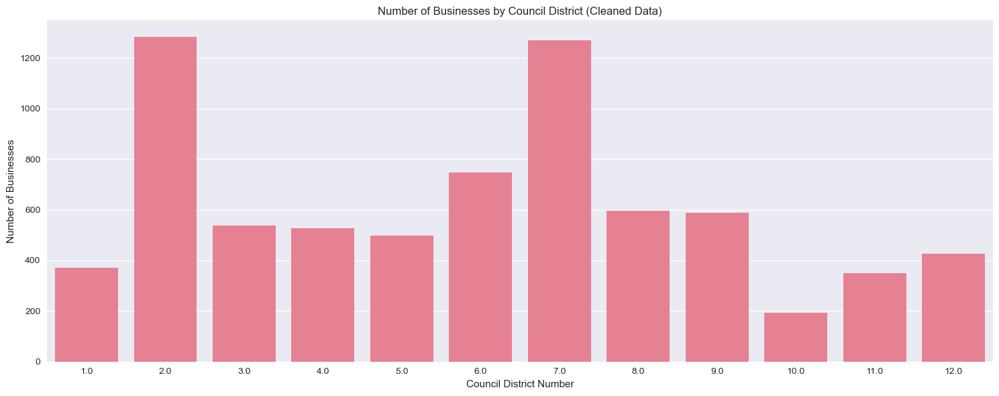


Business Count by Council District (Cleaned):
    council_district_clean  count
1                      2.0   1284
6                      7.0   1270
5                      6.0    748
7                      8.0    596
8                      9.0    587
2                      3.0    537
3                      4.0    527
4                      5.0    497
11                    12.0    426
0                      1.0    370
10                    11.0    349
9                     10.0    192


In [ ]:
# Clean council district data using regex to extract numeric part
# Create cleaned council district column
license['council_district_clean'] = license['council_district'].str.extract('(\d+)').astype(float)

# Analyze business distribution by cleaned council district
district_counts = license.groupby('council_district_clean').size().reset_index(name='count')

# Create bar plot with cleaned data
plt.figure(figsize=(15, 6))
sns.barplot(data=district_counts, x='council_district_clean', y='count')
plt.title('Number of Businesses by Council District (Cleaned Data)')
plt.xlabel('Council District Number')
plt.ylabel('Number of Businesses')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

# Print district statistics
print("\nBusiness Count by Council District (Cleaned):")
print(district_counts.sort_values('count', ascending=False))

# Save the cleaned dataset
license.to_excel('Atlanta_Business_License_Records_2025_cleaned.xlsx', index=False)

<Figure size 1500x600 with 0 Axes>

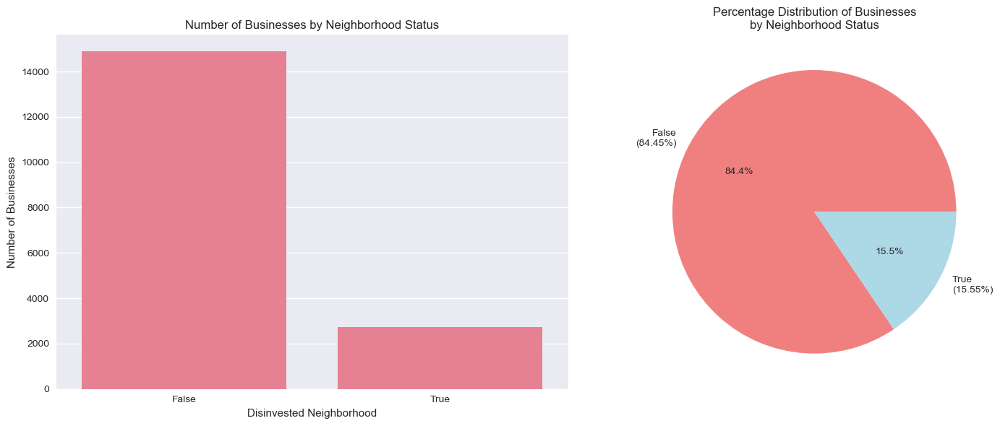


Business Distribution in Disinvested Neighborhoods:

Counts:
disinvested_neighborhood
False    14883
True      2740
Name: count, dtype: int64

Percentages:
disinvested_neighborhood
False    84.45
True     15.55
Name: count, dtype: float64


In [13]:
# Create visualization for disinvested neighborhoods
plt.figure(figsize=(15, 6))

# Create two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plot 1: Bar plot of business counts
disinvested_counts = license['disinvested_neighborhood'].value_counts()
sns.barplot(x=disinvested_counts.index, y=disinvested_counts.values, ax=ax1)
ax1.set_title('Number of Businesses by Neighborhood Status')
ax1.set_xlabel('Disinvested Neighborhood')
ax1.set_ylabel('Number of Businesses')

# Plot 2: Pie chart showing percentage distribution
disinvested_percent = (disinvested_counts / disinvested_counts.sum() * 100).round(2)
ax2.pie(disinvested_percent, labels=[f'{idx}\n({val}%)' for idx, val in disinvested_percent.items()], 
        autopct='%1.1f%%', colors=['lightcoral', 'lightblue'])
ax2.set_title('Percentage Distribution of Businesses\nby Neighborhood Status')

plt.tight_layout()
plt.show()

# Print detailed statistics
print("\nBusiness Distribution in Disinvested Neighborhoods:")
print("\nCounts:")
print(disinvested_counts)
print("\nPercentages:")
print(disinvested_percent)

### Section 4: Relationships and Comparisons
- **Stacked bar chart of license_classification by council_district**  
  Show how business sectors vary by district.  
  *Purpose:* Reveal which council districts have more retail, service, or food-related businesses.  

- **Count plot comparing disinvested_neighborhood by naics_name**  
  Compare counts of business types between disinvested and non-disinvested neighborhoods.  
  *Purpose:* Assess whether certain business categories are more common in specific socioeconomic areas.  

<Figure size 1500x800 with 0 Axes>

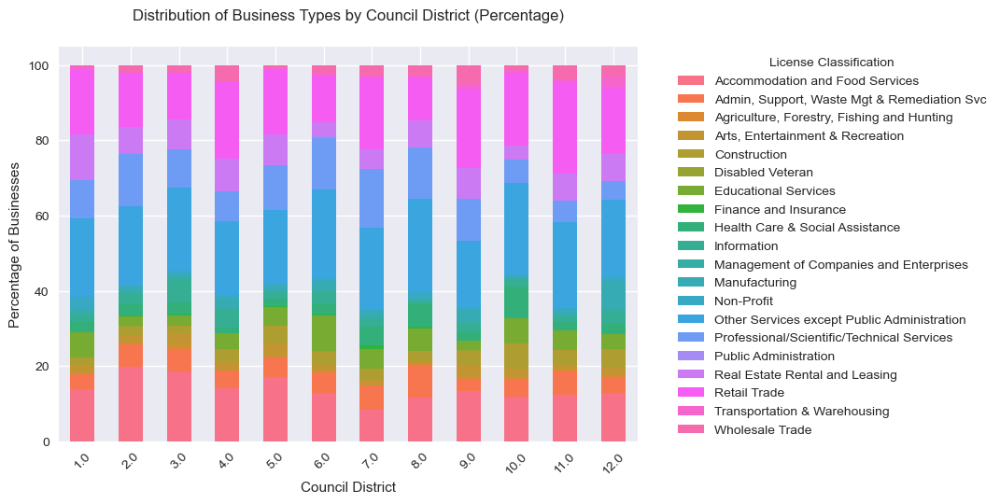


Percentage breakdown by district:
license_classification  Accommodation and Food Services  \
council_district_clean                                    
1.0                                               13.78   
2.0                                               19.94   
3.0                                               18.62   
4.0                                               14.04   
5.0                                               17.10   
6.0                                               12.97   
7.0                                                8.43   
8.0                                               11.74   
9.0                                               13.29   
10.0                                              11.98   
11.0                                              12.32   
12.0                                              12.91   

license_classification  Admin, Support, Waste Mgt & Remediation Svc  \
council_district_clean                                             

In [25]:
# Calculate percentages instead of raw counts
cross_tab_pct = cross_tab.div(cross_tab.sum(axis=1), axis=0) * 100

# Create a custom color palette with more distinct colors
colors = sns.color_palette("husl", n_colors=len(cross_tab_pct.columns)) + \
         sns.color_palette("Set2", n_colors=len(cross_tab_pct.columns)) + \
         sns.color_palette("Paired", n_colors=len(cross_tab_pct.columns))

# Create stacked bar chart
plt.figure(figsize=(15, 8))
cross_tab_pct.plot(kind='bar', stacked=True, color=colors[:len(cross_tab_pct.columns)])

# Customize the plot
plt.title('Distribution of Business Types by Council District (Percentage)', pad=20)
plt.xlabel('Council District')
plt.ylabel('Percentage of Businesses')
plt.legend(title='License Classification', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)

# Adjust layout to prevent label cutoff
plt.show()

# Print the numerical breakdown
print("\nPercentage breakdown by district:")
print(cross_tab_pct.round(2))

<Figure size 1500x1000 with 0 Axes>

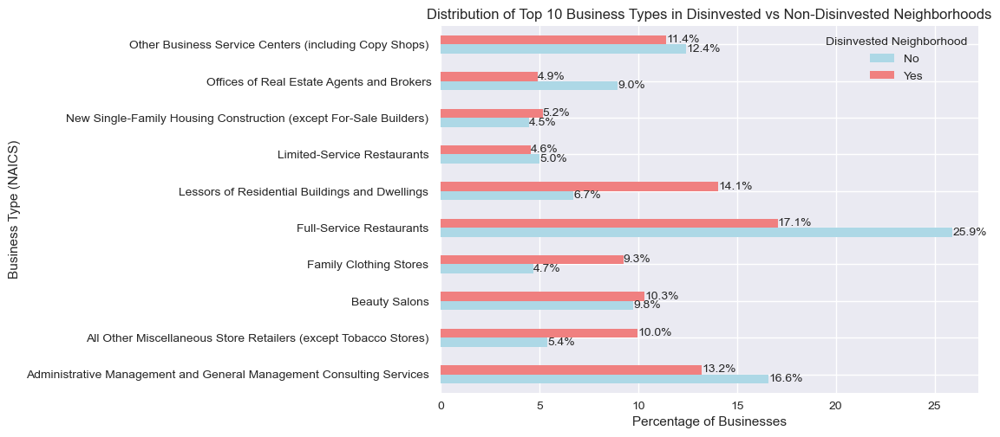


Percentage breakdown by neighborhood type:
disinvested_neighborhood                            False  True 
naics_name                                                      
Administrative Management and General Managemen...  16.60  13.22
All Other Miscellaneous Store Retailers (except...   5.41   9.98
Beauty Salons                                        9.76  10.34
Family Clothing Stores                               4.71   9.25
Full-Service Restaurants                            25.91  17.07
Lessors of Residential Buildings and Dwellings       6.73  14.06
Limited-Service Restaurants                          5.01   4.57
New Single-Family Housing Construction (except ...   4.47   5.17
Offices of Real Estate Agents and Brokers            8.97   4.93
Other Business Service Centers (including Copy ...  12.44  11.42


In [24]:
# Get top 10 business types overall
top_10_businesses = license['naics_name'].value_counts().head(10).index

# Filter for top 10 business types
df_filtered = license[license['naics_name'].isin(top_10_businesses)]

# Calculate percentages within each neighborhood type
pct_by_neighborhood = pd.crosstab(df_filtered['naics_name'], 
                                 df_filtered['disinvested_neighborhood'],
                                 normalize='columns') * 100

# Create plot with larger, more square dimensions
plt.figure(figsize=(15, 10))

# Create the bar plot
ax = pct_by_neighborhood.plot(kind='barh', stacked=False,
                            color=['lightblue', 'lightcoral'])

# Customize the plot
plt.title('Distribution of Top 10 Business Types in Disinvested vs Non-Disinvested Neighborhoods')
plt.xlabel('Percentage of Businesses')
plt.ylabel('Business Type (NAICS)')
plt.legend(title='Disinvested Neighborhood', labels=['No', 'Yes'])

# Add percentage labels on the bars
for container in ax.containers:
    ax.bar_label(container, fmt='%.1f%%')

# Show plot
plt.show()

# Print the numerical breakdown
print("\nPercentage breakdown by neighborhood type:")
print(pct_by_neighborhood.round(2))